In [149]:
import os

os.environ["CUDA_VISIBLE_DEVICES"]= '3'

import dgl
import h5py
import time
import numpy as np
import torch
import networkx as nx
from dgl.nn import GMMConv
import matplotlib.pyplot as plt
import torch.nn.functional as F
from GDL_CC_support import create_log_file_name, apply_filter, add_additive_noise, pre_processing, order_data, \
    mse_complex, mse_complex_summed, order_data_single_input

#device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

device = torch.device('cuda')

from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [150]:
path_to_data = '../../tmp_folder_27/'
name_dataset = 'DATA_CRT_32_sim_ver10.h5'
f_handle = h5py.File(path_to_data+name_dataset,'r')

In [151]:
print('CRT partitions: ', f_handle['input_data'].shape)
print('Spiral partitions: ', f_handle['input_data_spirals'].shape)

CRT partitions:  (9600, 6208, 40)
Spiral partitions:  (9600, 4528, 40)


In [152]:
path_to_data = '../../tmp_folder_27/'
name_dataset = 'DATA_CRT_32_sim_ver10.h5'
f_handle = h5py.File(path_to_data+name_dataset,'r')

n_cases = f_handle['input_data'].shape[0]
n_kspoint = f_handle['input_data'].shape[1]
n_coil = f_handle['input_data'].shape[2]
n_cases = 5000

sta_time = time.time()
x_raw = torch.tensor(f_handle['input_data'][:n_cases,:n_kspoint,:n_coil], dtype=torch.float32)
y_raw = torch.tensor(f_handle['output_data'][:n_cases,:n_kspoint,:n_coil], dtype=torch.float32)
print('Load in ', time.time()-sta_time)


sta_time = time.time()
af_mat = torch.tensor(
    np.repeat(
        np.array(
            f_handle['AF_vec']).transpose(), 
        40, axis=1), 
    dtype=torch.float32)

hf_mat = torch.tensor(
    np.repeat(
        np.array(
            f_handle['HF_vec']).transpose(), 
        40, axis=1), 
    dtype=torch.float32)

edge_attr_raw = torch.tensor(np.array(f_handle['edge_attr']), dtype=torch.float32)
edge_index_raw = torch.tensor(np.array(f_handle['edge_index']) - 1,
                              dtype=torch.long)  # minus one is because of different indexinf between python and matlab

pkor = torch.tensor(np.array(f_handle['pkor_vec']), dtype=torch.float32).to(device)

print('Load the rest in ', time.time()-sta_time)

sta_time = time.time()
x_pp, x_vl_pp, norm_x = pre_processing(x_raw, af_mat, hf_mat, n_coi=20)
y_pp, y_vl_pp, norm_y = pre_processing(y_raw, af_mat, hf_mat, n_coi=20)
print('Load in ', time.time()-sta_time)

g = dgl.graph((edge_index_raw[0,:], edge_index_raw[1,:])).to(device)
g.edata['w'] = edge_attr_raw.to(device)


Load in  116.70376205444336
Load the rest in  0.2860231399536133
Load in  6.612555742263794


In [153]:
path_to_data = '../../tmp_folder_27/'
name_dataset = 'DATA_CRT_32_sim_ver10.h5'
f_handle = h5py.File(path_to_data+name_dataset,'r')

n_cases = f_handle['input_data_spirals'].shape[0]
n_kspoint = f_handle['input_data_spirals'].shape[1]
n_coil = f_handle['input_data_spirals'].shape[2]
n_cases = 5000


sta_time = time.time()
x_raw_spi = torch.tensor(f_handle['input_data_spirals'][:n_cases,:n_kspoint,:n_coil], dtype=torch.float32)
y_raw_spi = torch.tensor(f_handle['output_data_spirals'][:n_cases,:n_kspoint,:n_coil], dtype=torch.float32)
print('Load spirals input and output data in ', time.time()-sta_time)


sta_time = time.time()
af_mat_spiral = torch.tensor(
    np.repeat(
        np.array(
            f_handle['AF_vec_spiral']).transpose(), 
        40, axis=1), 
    dtype=torch.float32)

hf_mat_spiral = torch.tensor(
    np.repeat(
        np.array(
            f_handle['HF_vec_spiral']).transpose(), 
        40, axis=1), 
    dtype=torch.float32)

edge_attr_raw_spiral = torch.tensor(np.array(f_handle['edge_attr_spiral']), dtype=torch.float32)
edge_index_raw_spiral = torch.tensor(np.array(f_handle['edge_index_spiral']) - 1,
                              dtype=torch.long)  # minus one is because of different indexinf between python and matlab


pkor_spiral = torch.tensor(np.array(f_handle['pkor_vec_spiral']), dtype=torch.float32).to(device)

print('Load the rest of the spiral data in ', time.time()-sta_time)


sta_time = time.time()
g_spi = dgl.graph((edge_index_raw_spiral[0,:], edge_index_raw_spiral[1,:])).to(device)
g_spi.edata['w'] = edge_attr_raw_spiral.to(device)
print('Graph for spirals were defined in ', time.time()-sta_time)

sta_time = time.time()
x_pp_spi, x_vl_pp_spi, norm_x_spi = pre_processing(x_raw_spi, af_mat_spiral, hf_mat_spiral, n_coi=20)
y_pp_spi, y_vl_pp_spi, norm_y_spi = pre_processing(y_raw_spi, af_mat_spiral, hf_mat_spiral, n_coi=20)
print('Pre-processed in ', time.time()-sta_time)



Load spirals input and output data in  83.01513648033142
Load the rest of the spiral data in  0.17982769012451172
Graph for spirals were defined in  0.014116764068603516


33600

In [155]:
class Net(torch.nn.Module):
    def __init__(self, in_chan, out_chan):
        super(Net, self).__init__()
        self.conv1 = GMMConv(in_chan, 20, 2, 10, 'mean', bias=False)
        torch.nn.init.uniform_(self.conv1.mu, -0.230, 0.230)
        torch.nn.init.uniform_(self.conv1.inv_sigma, 10, 11)
        
        #self.conv2 = GMMConv(20, 20, 2, 20, 'mean', bias=False)
        #torch.nn.init.uniform_(self.conv2.mu, -0.230, 0.230)
        #torch.nn.init.uniform_(self.conv2.inv_sigma, 10, 11)
        
        
        self.conv3 = GMMConv(20, 40, 2, 10, 'mean', bias=False)
        torch.nn.init.uniform_(self.conv3.mu, -0.230, 0.230)
        torch.nn.init.uniform_(self.conv3.inv_sigma, 10, 11)
        
    def forward(self, g, featu, p_coord):
        x = torch.tanh(self.conv1(g, featu, p_coord))
        #x = torch.tanh(self.conv2(g, x, p_coord))
        x = self.conv3(g, x, p_coord)
        return x
        
model = Net(in_chan = 40, out_chan = 40).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)

In [156]:
def train(data_train_x, data_train_y, mini_batch=10, noise_lvl=0):
    model.train()
    total_loss = 0
    mini_batch_idx = 0
    mini_batch_loss = 0
    
    for i in np.arange(data_train_x.shape[0]):
        mini_batch_idx += 1
        inn = data_train_x[i, ].to(device)

        optimizer.zero_grad()
        pred = model(g, inn, pkor)
        loss = F.mse_loss(pred, data_train_y[i, ].to(device))
        # loss_2 = mse_complex_summed(pred, data_b.y, n_coi=1)
        # loss = loss_1 + loss_2
        # loss2 = mse_complex(pred, data_b.y)
        mini_batch_loss += loss / mini_batch
        #
        if mini_batch_idx == mini_batch:
            mini_batch_loss.backward()
            optimizer.step()
            mini_batch_idx = 0
            mini_batch_loss = 0

        total_loss += loss / x_raw.shape[0]
    return total_loss

In [214]:
def train_with_noise(data_train_x, data_train_y, g_filt, mini_batch=10, noise_lvl=0):
    model.train()
    total_loss = 0
    mini_batch_idx = 0
    mini_batch_loss = 0
    maximum_signal = data_train_x.max() * 0.0005
    
    for i in np.arange(data_train_x.shape[0]):
        mini_batch_idx += 1
        inn = data_train_x[i, ]
        nois = maximum_signal * torch.rand(1) * epoch * torch.randn_like(inn)
        inn = (inn.to(device) + nois.to(device)) * g_filt

        optimizer.zero_grad()
        pred = model(g, inn, pkor)
        loss = F.mse_loss(pred, data_train_y[i, ].to(device))

        mini_batch_loss += loss / mini_batch

        if mini_batch_idx == mini_batch:
            mini_batch_loss.backward()
            optimizer.step()
            mini_batch_idx = 0
            mini_batch_loss = 0

        total_loss += loss / x_raw.shape[0]
    return total_loss

In [ ]:
def test(dat_to_test, g, pkor):
    model.eval()
    pred_all = np.zeros(tuple(dat_to_test.shape))
    for i in np.arange(dat_to_test.shape[0]):
        inn = dat_to_test[i, ].to(device)
        pred = model(g, inn, pkor)
        pred_all[i, :, :] = (pred.cpu().detach().numpy())
        
    return pred_all

def test_add_noise(x, g, pkor, h, a, norm, noise_lvl=30):
    model.eval()
    pred_all = np.zeros(tuple(dat_to_test.shape))
    g_filt = ((h*a)/norm).to(device)
    noise_lvl = x.max() * 0.0001 * noise_lvl
    for i in np.arange(x.shape[0]):
        inn = x[i, ].to(device)
        inn = (inn + noise_lvl * torch.randn_like(inn)) * g_filt
        pred = model(g, inn, pkor)
        pred_all[i, :, :] = (pred.cpu().detach().numpy())
        
    return pred_all

In [157]:
N = n_cases
old_loss = 0
g_filt = (hf_mat * af_mat) / norm_x 

for epoch in range(1,150):
    sta = time.time()

    cur_loss = train(x_pp[0:N,], y_pp[0:N,])
    #cur_loss = train_with_noise(x_raw[0:N,], y_pp[0:N,], g_filt.to(device))
    # tes_loss, tes_va = test()
    sto = time.time() - sta
    
    delt_loss = old_loss - cur_loss
    
    
    # log = 'Epoch: {:03d}, Train: {:.8f}, Validation: Mean {:.8f}, Variance {:.8f}, Time: {:.4f}'
    log = 'Epoch: {:03d}, Train: {:.8f}, Time: {:.4f}, Change in loss: {:.8f}'

    print(log.format(epoch, cur_loss, sto,delt_loss))
    old_loss = cur_loss

torch.save(model.state_dict(), './Model_toy_example_after_1st_training.pt')

Epoch: 001, Train: 0.00002378, Time: 73.9870, Change in loss: -0.00002378
Epoch: 002, Train: 0.00001159, Time: 76.5967, Change in loss: 0.00001219
Epoch: 003, Train: 0.00000951, Time: 75.1124, Change in loss: 0.00000208
Epoch: 004, Train: 0.00000843, Time: 75.2577, Change in loss: 0.00000108
Epoch: 005, Train: 0.00000772, Time: 75.5071, Change in loss: 0.00000071
Epoch: 006, Train: 0.00000720, Time: 75.2376, Change in loss: 0.00000052
Epoch: 007, Train: 0.00000680, Time: 73.4029, Change in loss: 0.00000040
Epoch: 008, Train: 0.00000648, Time: 74.6239, Change in loss: 0.00000032
Epoch: 009, Train: 0.00000622, Time: 75.2491, Change in loss: 0.00000026
Epoch: 010, Train: 0.00000600, Time: 74.1437, Change in loss: 0.00000022
Epoch: 011, Train: 0.00000582, Time: 74.9781, Change in loss: 0.00000018
Epoch: 012, Train: 0.00000566, Time: 75.2595, Change in loss: 0.00000016
Epoch: 013, Train: 0.00000553, Time: 75.7772, Change in loss: 0.00000014
Epoch: 014, Train: 0.00000541, Time: 75.7153, Chan

KeyboardInterrupt: 

In [22]:
model.load_state_dict(torch.load('./Model_toy_example_after_1st_training.pt'))

pred_spi = test(x_pp_spi, g_spi, pkor_spiral )
pred_crt = test(x_pp, g, pkor)

y_gt_spi_rec = reco_to_img_space(y_pp_spi[:480].numpy(), DC_spi, W_spi)
y_pr_spi_rec = reco_to_img_space(pred_spi[:480], DC_spi, W_spi)

y_gt_crt_rec = reco_to_img_space(y_pp[:480].numpy(), DC_crt, W_crt)
y_pr_crt_rec = reco_to_img_space(pred_crt[:480], DC_crt, W_crt)

In [213]:

fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Image(z=np.sum(y_gt_crt_rec[:,:,slc,2,:,0],2).imag), row=1, col=1)
'''fig.add_trace(go.image(np.sum(y_pr_crt_rec[:,:,slc,2,:,0],2).imag), row=1, col=2)
fig.add_trace(go.image(np.sum(y_gt_spi_rec[:,:,slc,2,:,0],2).imag), row=1, col=3)
fig.add_trace(go.image(np.sum(y_pr_spi_rec[:,:,slc,2,:,0],2).imag), row=1, col=4)'''

#fig.update_layout(height=400)
fig.show()

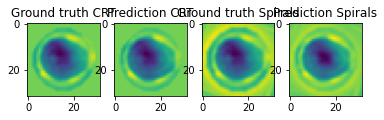

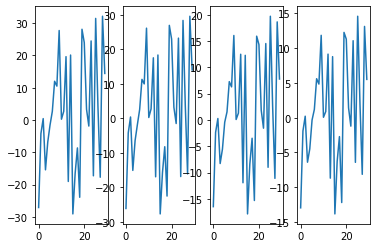

In [201]:
slc = 7

plt.figure()
sr = 1
sc = 4
plt.subplot(sr,sc,1)
plt.imshow(np.sum(y_gt_crt_rec[:,:,slc,2,:,0],2).imag)
plt.title('Ground truth CRT')

plt.subplot(sr,sc,2)
plt.imshow(np.sum(y_pr_crt_rec[:,:,slc,2,:,0],2).imag)
plt.title('Prediction CRT')

plt.subplot(sr,sc,3)
plt.imshow(np.sum(y_gt_spi_rec[:,:,slc,2,:,0],2).imag)
plt.title('Ground truth Spirals')

plt.subplot(sr,sc,4)
plt.imshow(np.sum(y_pr_spi_rec[:,:,slc,2,:,0],2).imag)
plt.title('Prediction Spirals')


plt.figure()
plt.subplot(sr,sc,1)
plt.plot(np.sum(y_gt_crt_rec[15,10,slc,:,:,0],1).real)

plt.subplot(sr,sc,2)
plt.plot(np.sum(y_pr_crt_rec[15,10,slc,:,:,0],1).real)

plt.subplot(sr,sc,3)
plt.plot(np.sum(y_gt_spi_rec[15,10,slc,:,:,0],1).real)

plt.subplot(sr,sc,4)
plt.plot(np.sum(y_pr_spi_rec[15,10,slc,:,:,0],1).real)

In [217]:
model.load_state_dict(torch.load('./Model_toy_example_after_1st_training.pt'))

N = n_cases
old_loss = 0
g_filt = (hf_mat * af_mat) / norm_x 
for epoch in range(1,30):
    sta = time.time()

    #cur_loss = train(x_pp[0:N,], y_pp[0:N,])
    cur_loss = train_with_noise(x_raw[0:N,], y_pp[0:N,], g_filt.to(device))
    # tes_loss, tes_va = test()
    sto = time.time() - sta
    
    delt_loss = old_loss - cur_loss
    
    
    # log = 'Epoch: {:03d}, Train: {:.8f}, Validation: Mean {:.8f}, Variance {:.8f}, Time: {:.4f}'
    log = 'Epoch: {:03d}, Train: {:.8f}, Time: {:.4f}, Change in loss: {:.8f}'

    print(log.format(epoch, cur_loss, sto,delt_loss))
    old_loss = cur_loss
    
torch.save(model.state_dict(), './Model_toy_example_after_2nd_training.pt')

Epoch: 001, Train: 0.00000313, Time: 86.8386, Change in loss: -0.00000313
Epoch: 002, Train: 0.00000325, Time: 85.3271, Change in loss: -0.00000012
Epoch: 003, Train: 0.00000325, Time: 87.4427, Change in loss: -0.00000001
Epoch: 004, Train: 0.00000326, Time: 84.2861, Change in loss: -0.00000001
Epoch: 005, Train: 0.00000328, Time: 87.2711, Change in loss: -0.00000001
Epoch: 006, Train: 0.00000329, Time: 84.6767, Change in loss: -0.00000002
Epoch: 007, Train: 0.00000331, Time: 87.1514, Change in loss: -0.00000002
Epoch: 008, Train: 0.00000334, Time: 85.8291, Change in loss: -0.00000003
Epoch: 009, Train: 0.00000336, Time: 85.8002, Change in loss: -0.00000003
Epoch: 010, Train: 0.00000339, Time: 87.2705, Change in loss: -0.00000003
Epoch: 011, Train: 0.00000342, Time: 86.6577, Change in loss: -0.00000003
Epoch: 012, Train: 0.00000346, Time: 85.4686, Change in loss: -0.00000004
Epoch: 013, Train: 0.00000349, Time: 85.6294, Change in loss: -0.00000003
Epoch: 014, Train: 0.00000352, Time: 8

In [220]:
def test_add_noise(x, g, pkor, h, a, norm, noise_lvl=30):
    model.eval()
    pred_all = np.zeros(tuple(x.shape))
    g_filt = ((h*a)/norm).to(device)
    noise_lvl = x.max() * 0.0001 * noise_lvl
    for i in np.arange(x.shape[0]):
        inn = x[i, ].to(device)
        inn = (inn + noise_lvl * torch.randn_like(inn)) * g_filt
        pred = model(g, inn, pkor)
        pred_all[i, :, :] = (pred.cpu().detach().numpy())
        
    return pred_all

In [223]:
pred_spi_nois = test_add_noise(x_pp_spi, g_spi, pkor_spiral, hf_mat_spiral, af_mat_spiral, norm_x_spi, noise_lvl=5)
pred_crt_nois = test_add_noise(x_pp, g, pkor, hf_mat, af_mat, norm_x, noise_lvl=5)

y_gt_spi_rec_nois = reco_to_img_space(y_pp_spi[:480].numpy(), DC_spi, W_spi)
y_pr_spi_rec_nois = reco_to_img_space(pred_spi_nois[:480], DC_spi, W_spi)

y_gt_crt_rec_nois = reco_to_img_space(y_pp[:480].numpy(), DC_crt, W_crt)
y_pr_crt_rec_nois = reco_to_img_space(pred_crt_nois[:480], DC_crt, W_crt)

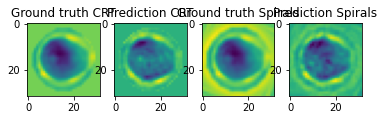

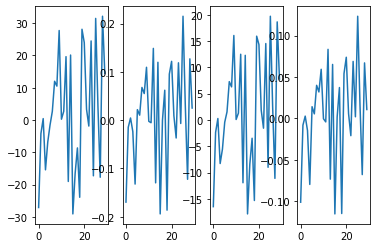

In [224]:
slc = 7

plt.figure()
sr = 1
sc = 4
plt.subplot(sr,sc,1)
plt.imshow(np.sum(y_gt_crt_rec_nois[:,:,slc,2,:,0],2).imag)
plt.title('Ground truth CRT')

plt.subplot(sr,sc,2)
plt.imshow(np.sum(y_pr_crt_rec_nois[:,:,slc,2,:,0],2).imag)
plt.title('Prediction CRT')

plt.subplot(sr,sc,3)
plt.imshow(np.sum(y_gt_spi_rec_nois[:,:,slc,2,:,0],2).imag)
plt.title('Ground truth Spirals')

plt.subplot(sr,sc,4)
plt.imshow(np.sum(y_pr_spi_rec_nois[:,:,slc,2,:,0],2).imag)
plt.title('Prediction Spirals')


plt.figure()
plt.subplot(sr,sc,1)
plt.plot(np.sum(y_gt_crt_rec_nois[15,10,slc,:,:,0],1).real)

plt.subplot(sr,sc,2)
plt.plot(np.sum(y_pr_crt_rec_nois[15,10,slc,:,:,0],1).real)

plt.subplot(sr,sc,3)
plt.plot(np.sum(y_gt_spi_rec_nois[15,10,slc,:,:,0],1).real)

plt.subplot(sr,sc,4)
plt.plot(np.sum(y_pr_spi_rec_nois[15,10,slc,:,:,0],1).real)



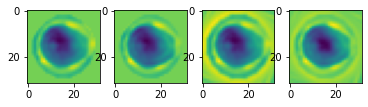

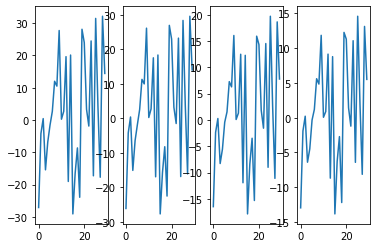

In [15]:
def test_2(x,h,a,norm):
    model.eval()
    pred_all = []
    g_filt = ((h*a)/norm).to(device)
    # inn = (data_b.x + (epoch * noise_lvl * 8.4375e+09) * torch.randn_like(data_b.x)) * gf_matnoise_lvl
    noise_lvl = x.max() * 0.0001 * 30
    for i in np.arange(x.shape[0]):
        inn = x[i, ].to(device)
        inn = (inn + noise_lvl * torch.randn_like(inn)) * g_filt
        pred = model(g, inn, pkor)
        pred_all.append(pred.cpu().detach().numpy())
    return pred_all

In [159]:
def test_spi(in_dat):
    model.eval()
    pred_all = np.zeros(tuple(in_dat.shape))
    for i in np.arange(in_dat.shape[0]):
        inn = in_dat[i, ].to(device)
        pred = model(g_spi, inn, pkor_spiral)
        pred_all[i,:,:] = pred.cpu().detach().numpy()
        
    return pred_all

(5000, 4528, 40)

In [36]:
pth2save = 'output_data_spi_32_ver_0_2.h5'

sta_time = time.time()
fh = h5py.File(pth2save,'a')
fh.create_dataset('spi_pr', data=pred_spi)
fh.close()
print('Saved in ', time.time()-sta_time)

Saved in  16.750696897506714


In [25]:
pth2save = 'output_data_spi_32_ver_0_1.h5'

sta_time = time.time()
fh = h5py.File(pth2save,'a')
fh.create_dataset('y_pp_pred', data=y_pp_pred)
fh.close()
print('Saved in ', time.time()-sta_time)





Saved in  31.476426362991333


In [43]:
x_pp_spi.shape

torch.Size([9600, 4928, 40])

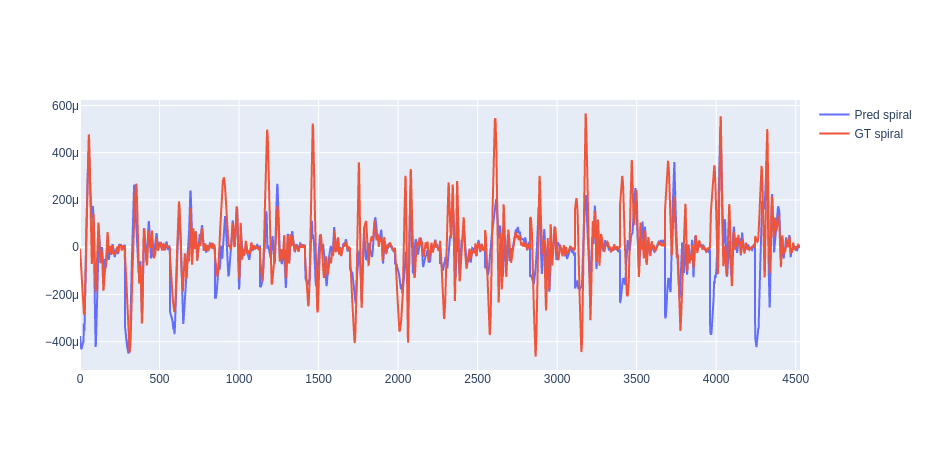

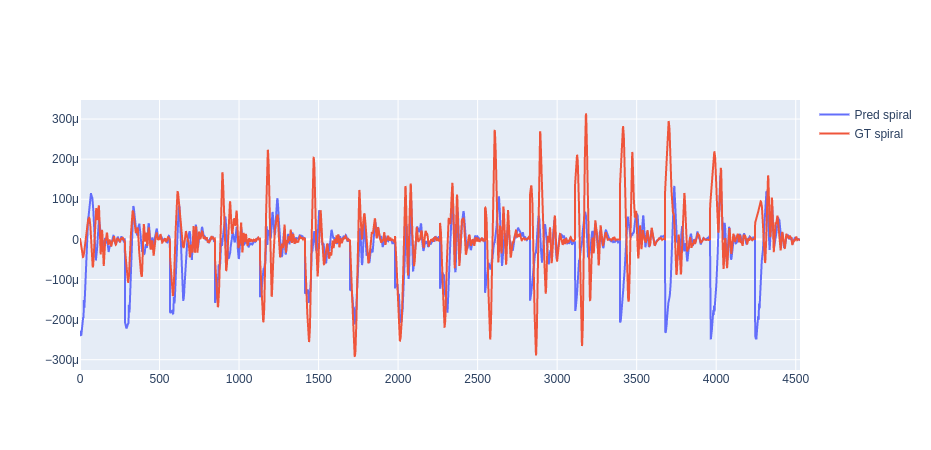

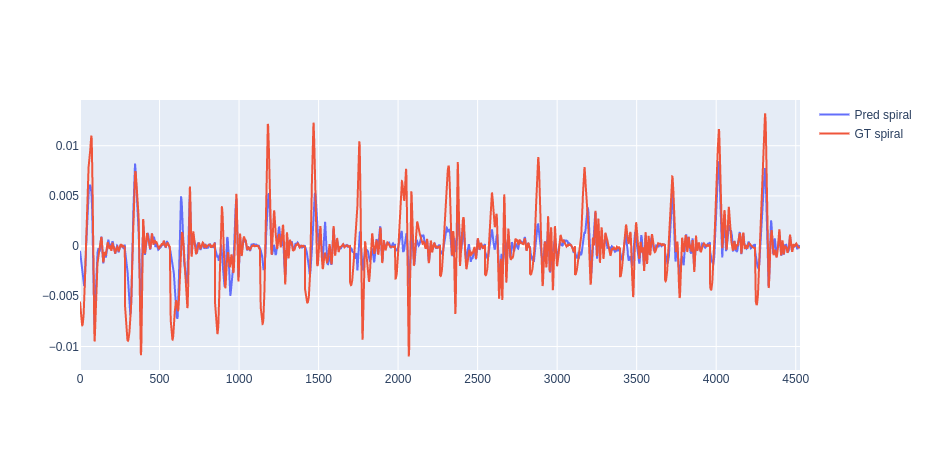

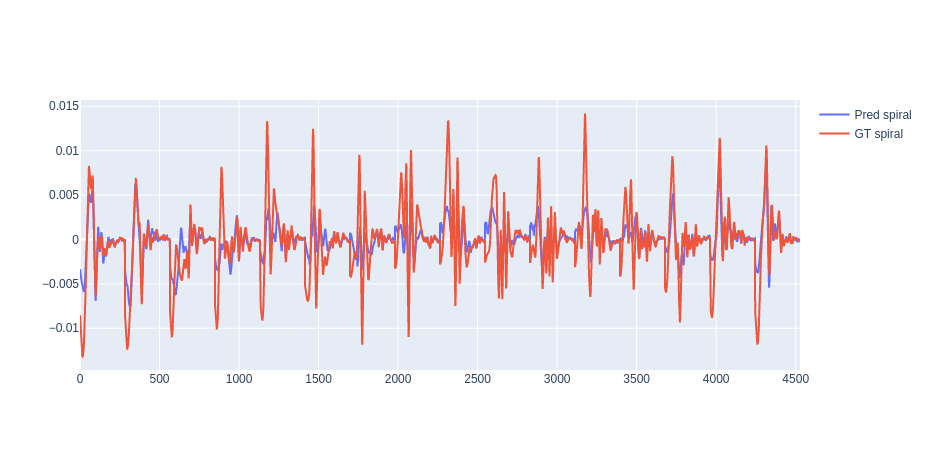

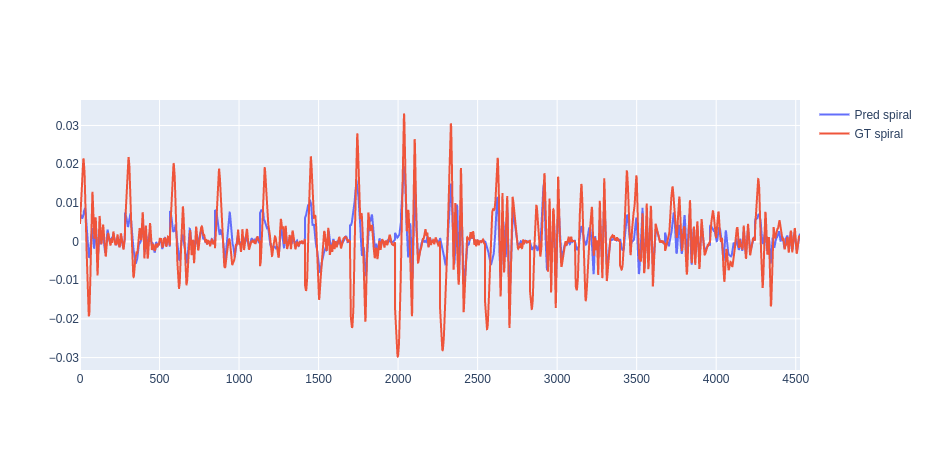

...

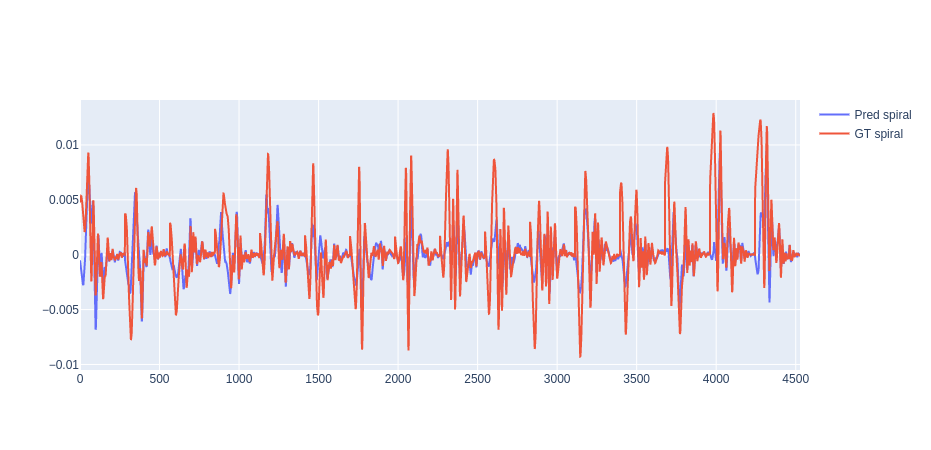

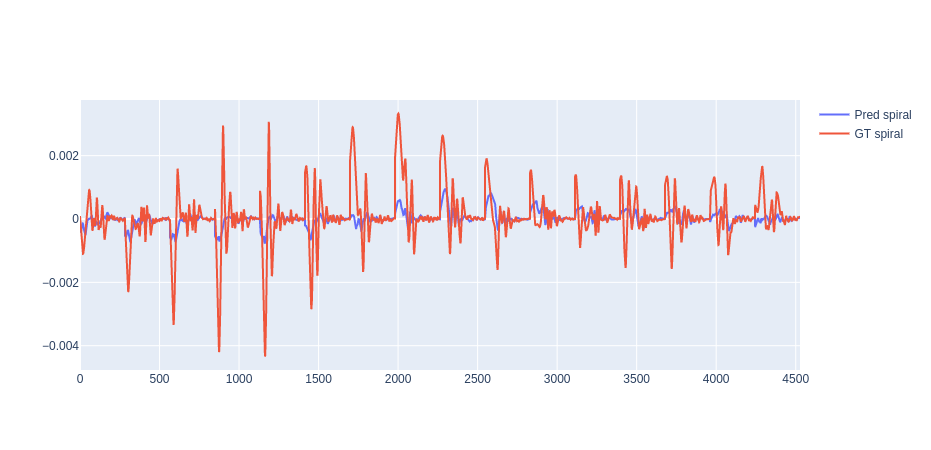

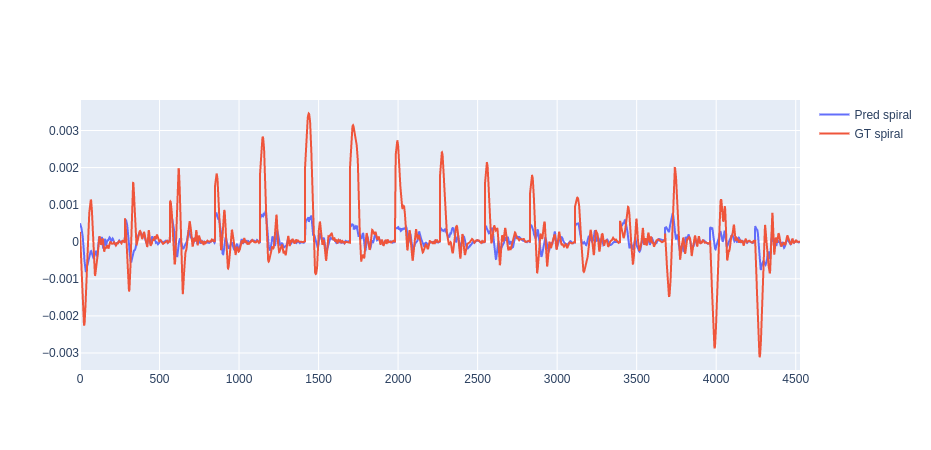

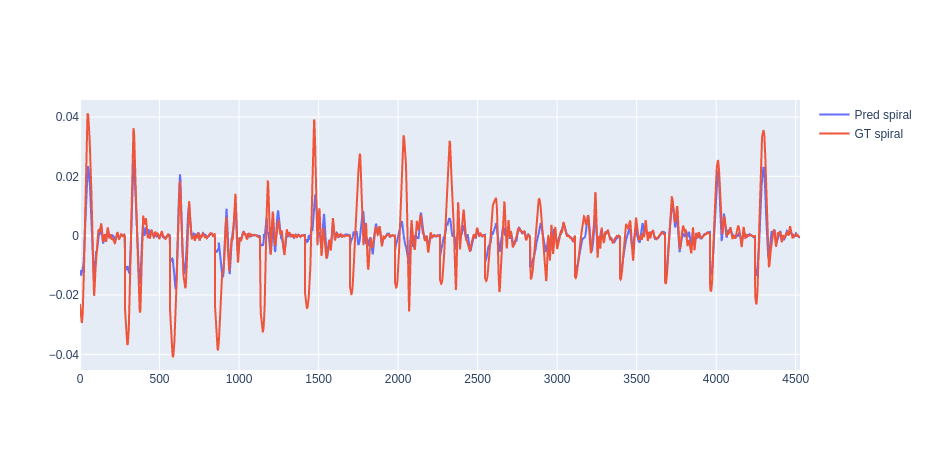

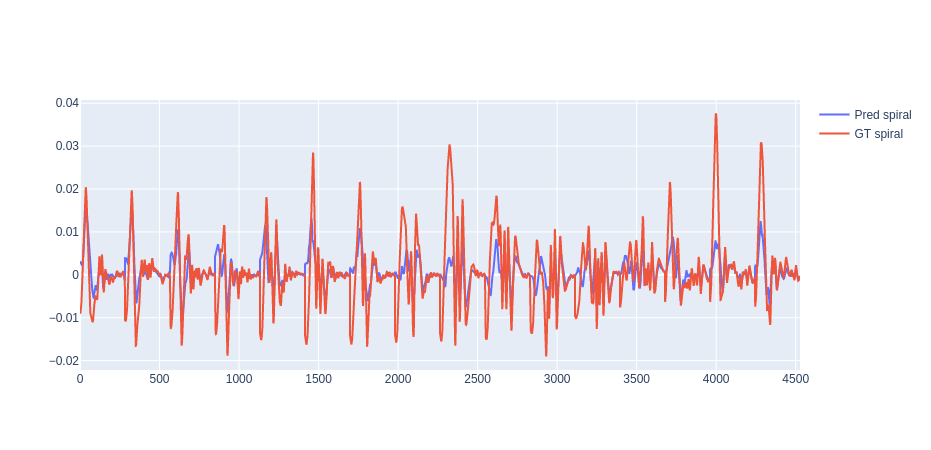

In [35]:
#pred_spi[0].shape
cae = 11
for coi in np.arange(0,20):
    fig = go.Figure()
    fig.add_trace(go.Scatter(y=pred_spi[cae][:, coi], name='Pred spiral'))
    fig.add_trace(go.Scatter(y=y_pp_spi[cae, :, coi], name='GT spiral'))
    fig.show()
                  

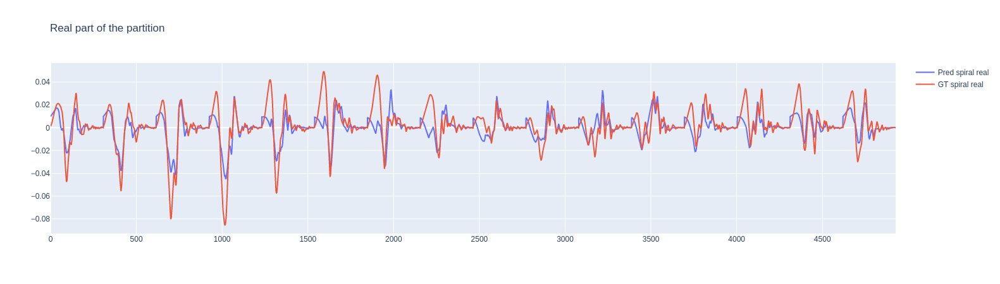

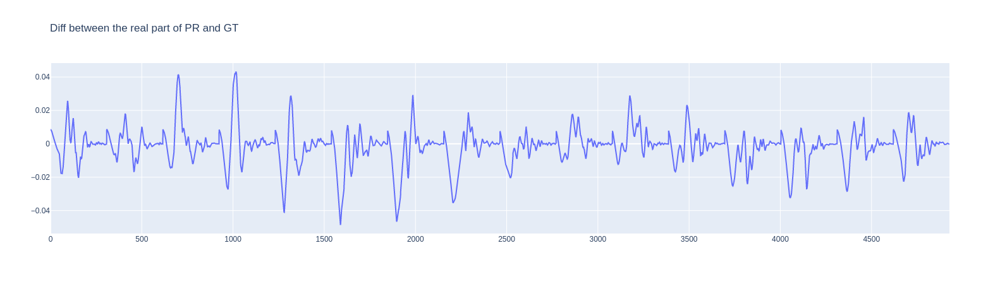

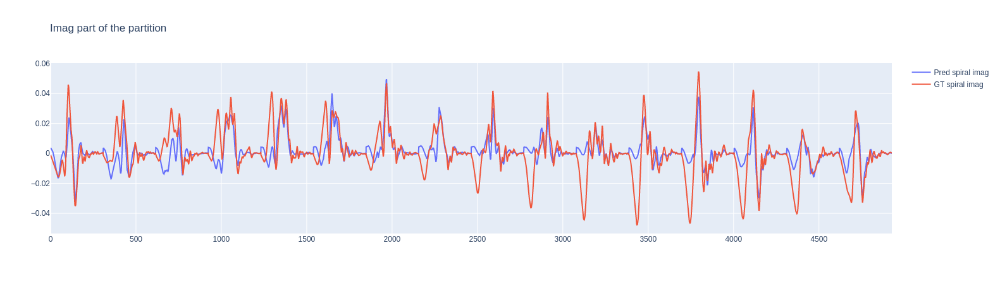

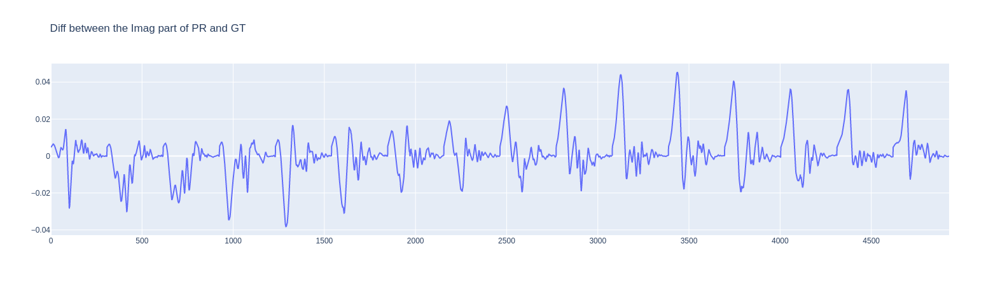

In [23]:
cae = 1

prd = pred_spi[cae]
prd = np.sum(prd[:,0:20] + 1j * prd[:,20:], 1)

gt = y_pp_spi[cae,:,:].numpy()
gt = np.sum(gt[:, 0:20] + 1j * gt[:, 20:], 1)

fig = go.Figure()
fig.add_trace(go.Scatter(y=prd.real, name='Pred spiral real'))
fig.add_trace(go.Scatter(y=gt.real, name='GT spiral real'))
fig.update_layout(title='Real part of the partition')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(y=prd.real - gt.real, name='Pred spiral real'))
fig.update_layout(title='Diff between the real part of PR and GT')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(y=prd.imag, name='Pred spiral imag'))
fig.add_trace(go.Scatter(y=gt.imag, name='GT spiral imag'))
fig.update_layout(title='Imag part of the partition')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(y=prd.imag-gt.imag, name='Pred spiral imag'))
fig.update_layout(title='Diff between the Imag part of PR and GT')
fig.show()




In [42]:
# reco the spirals and crt

def reco_noncart(csi_k, W, DCFPreG2, par):
    # input (20, 16, 388, 25, 16) # (coils, rings, nodes, partitions, time)
    csi_k = np.transpose(csi_k,[2,1,3,4,0])
    #print(csi_k.shape)
    #csi_k = np.transpose(csi_k,[2,3,1,0,4])  #= [4,3,2,1,0] + [2,1,3,4,0]
    csi_k = np.reshape(csi_k,[16*388,len(par["FOVslc"])*par["vs"]*20], "F")
    csi_k = np.transpose(np.tile(DCFPreG2, (csi_k.shape[1],1)),[1,0]) * csi_k
    csi_i = np.matmul(np.transpose(np.conjugate(W),[1,0]), csi_k)
    csi_i = np.reshape(csi_i,[32,32,len(par["FOVslc"]),par["vs"],20], "F")
    csi_i = Perform_FFT(csi_i,[2],[0,1]);
    csi_i = np.flip(np.flip(csi_i, 2), 1);
    return csi_i


def FOV_mask(N):
    Xc, Yc = np.meshgrid(np.linspace(-1,1,N), np.linspace(-1,1,N))

    ED = np.sqrt(np.power(Xc,2) + np.power(Yc,2))

    ED[ED>0.9] = np.nan
    ED[ED<=0.9] = 1

    return ED


def calc_dens_comp(kx_s, ky_s):
    R = np.sqrt(np.power(kx_s,2) + np.power(ky_s,2))
    R = np.unique(np.round(R, decimals=5))

    nc =len(R)

    DCFPreG2 = np.zeros([1, nc])

    for i in np.arange(1,nc-1):
        v1 = np.power(R[i]/np.max(R) + R[i+1]/np.max(R), 2) / 4
        v2 = np.power(R[i-1]/np.max(R) + R[i]/np.max(R), 2) / 4
        DCFPreG2[0,i] = np.pi*(v1-v2)

    DCFPreG2[0,0] = 0.25*np.pi* np.power(R[0]/np.max(R) + R[1]/np.max(R),2)
    v1 = np.power(1.5*R[nc-1]/np.max(R) - 0.5*R[nc-2]/np.max(R),2)
    v2 = np.power(0.5*R[nc-1]/np.max(R) + 0.5*R[nc-2]/np.max(R),2)
    DCFPreG2[0,nc-1] = np.pi*(v1-v2)

    
    DCFPreG2 = np.repeat(DCFPreG2, repeats = kx_s.shape[0], axis = 0)
    DCFPreG2 = DCFPreG2.flatten("F")
    return DCFPreG2


def Perform_FFT(OutArray, ApplyAlongDims, doFFT):

    if doFFT[0] == True:
        for i in ApplyAlongDims:
            OutArray = np.fft.ifftshift(OutArray, i)
            OutArray = np.fft.ifft(OutArray, axis = i)
            OutArray = np.fft.fftshift(OutArray, i)

    if doFFT[1] == True:
        for i in ApplyAlongDims:
            OutArray = np.fft.ifftshift(OutArray, i)
            OutArray = np.fft.fft(OutArray, axis = i)
            OutArray = np.fft.fftshift(OutArray, i)

    return OutArray


def create_brute_force_FT_matrix(In, GridX, GridY):

    N1 = GridX.shape[0]
    N2 = GridX.shape[1]

    NN1 = In[0]
    NN2 = In[1]

    XX, YY = np.meshgrid(np.arange(-NN1/2+1,NN1/2+1), np.arange(-NN2/2+1,NN2/2+1))

    ii = 1j

    W = np.zeros([np.size(GridX), NN1*NN2], dtype = 'complex_')
    kp = 0

    k_coord = np.zeros([np.size(GridX), 2])

    for j in range(N2):
        for k in range(N1):
            Map=np.exp(-ii*(GridX[k,j]*XX + GridY[k,j]*YY))

            W[kp,:] = Map.flatten("F")

            k_coord[kp,0] = GridX[k,j]
            k_coord[kp,1] = GridY[k,j]
            kp += 1

    return W, k_coord


def reco_to_img_space(x, DC, W):
    
    n_coi = np.int(x.shape[2]/2)
    n_ksp_s = x.shape[1]
    
    x = np.transpose(x, (2,1,0))
    x = x[:n_coi] + 1j * x[n_coi:]
    # remove annihilation filter
    x = np.transpose(x, (1,2,0))
    x = np.reshape(x, (n_ksp_s,-1), "F")
    x = DC[:,np.newaxis]*x
    x = np.matmul(np.transpose(np.conjugate(W)), x)
    x = np.reshape(x, (32, 32, 16, 30, -1, n_coi), "F")
    x = np.transpose(x, (0,1,2,3,5,4))
    x = Perform_FFT(x,[2],[0,1])
    x = np.flip(np.flip(x,1),2)
    return x




In [162]:
'''kx_spiral = h5read('Spiral_kxky_DensComp.h5','/kx');
ky_spiral = h5read('Spiral_kxky_DensComp.h5','/ky');
DC_spiral = h5read('Spiral_kxky_DensComp.h5','/DC');
'''

pth_spi_traj = '../../'
name_dataset = 'Spiral_kxky_DensComp.h5'
fh_spi = h5py.File(pth_spi_traj+name_dataset,'r')

kx_spi = 2*np.pi*np.array(fh_spi['kx'])
ky_spi = 2*np.pi*np.array(fh_spi['ky'])

kx_spi = np.reshape(kx_spi, [16, 320])
ky_spi = np.reshape(ky_spi, [16, 320])

kx_spi = np.reshape(kx_spi[:, 37:],[-1,1])
ky_spi = np.reshape(ky_spi[:, 37:],[-1,1])

DC_spi = np.array(fh_spi['DC'])

DC_spi = np.array(fh_spi['DC'])
DC_spi = np.reshape(DC_spi,[16, 320])
id_limit = 38-1;
DC_spi = DC_spi[:, id_limit:]
DC_spi = np.reshape(DC_spi, [-1,])

W_spi, k_coord_spi = create_brute_force_FT_matrix([32,32], kx_spi, ky_spi)

#print('shape kx_spi:', kx_spi.shape)

In [134]:
pth_spi_traj = '../../'
name_dataset = 'CRT_16_kxky.h5'
fh_crt = h5py.File(pth_spi_traj+name_dataset,'r')

n_circ = 16

kx_crt = np.array(fh_crt['kx'])
ky_crt = np.array(fh_crt['ky'])

kx_crt = np.transpose(kx_crt,[1,0])
ky_crt = np.transpose(ky_crt,[1,0])

kx_crt = np.pi * (kx_crt / (np.max(kx_crt)/((n_circ-0.5)/n_circ)) )
ky_crt = np.pi * (ky_crt / (np.max(ky_crt)/((n_circ-0.5)/n_circ)) )

W_crt, k_cood_crt = create_brute_force_FT_matrix([32, 32], kx_crt, ky_crt)


DC_crt = calc_dens_comp(kx_crt, ky_crt)
EDv = FOV_mask(32)
W_crt[:,np.isnan(EDv).flatten()] = 0


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in less_equal


In [135]:
kx_crt.shape

(388, 16)

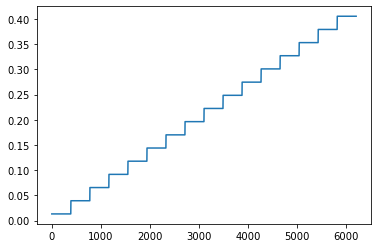

In [136]:
plt.plot(DC_crt)
plt.show()



In [94]:
#np.int(x_pp_spi.shape[2]/2)

print('dc shape:', DC_spi.shape)
print('x shape:', x_pp_spi.shape)
print('W shape:', W.shape)
print('kx shape:', kx_spi.shape)


dc shape: (4528,)
x shape: torch.Size([5000, 4528, 40])
W shape: (4528, 1024)
kx shape: (4528, 1)


In [164]:
#x_spi_recp = reco_to_img_space(x_pp_spi[:480].numpy(), DC_spi, W)
y_spi_recp = reco_to_img_space(y_pp_spi[:480].numpy(), DC_spi, W_spi)
pred_spi_rec = reco_to_img_space(pred_spi[:480], DC_spi, W_spi)

In [179]:
y_crt_rec = reco_to_img_space(y_pp[:480].numpy(), DC_crt, W_crt)
x_crt_rec = reco_to_img_space(pred_crt[:480], DC_crt, W_crt)

In [168]:
pred_crt.shape

AttributeError: 'list' object has no attribute 'shape'

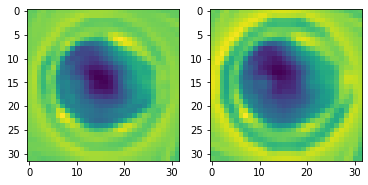

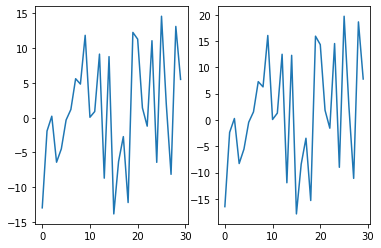

In [193]:
x_spi_recp.shape

slc = 7

plt.figure()

plt.subplot(1,2,1)
plt.imshow(np.sum(pred_spi_rec[:,:,slc,2,:,0],2).imag)

plt.subplot(1,2,2)
plt.imshow(np.sum(y_spi_recp[:,:,slc,2,:,0],2).imag)


plt.figure()
plt.subplot(1,2,1)
plt.plot(np.sum(pred_spi_rec[15,10,slc,:,:,0],1).real)

plt.subplot(1,2,2)
plt.plot(np.sum(y_spi_recp[15,10,slc,:,:,0],1).real)

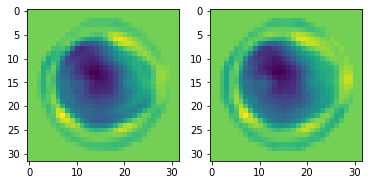

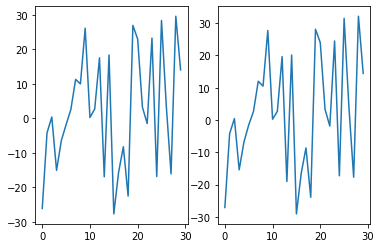

In [191]:
slc = 7

plt.figure()

plt.subplot(1,2,1)
plt.imshow(np.sum(x_crt_rec[:,:,slc,2,:,0],2).imag)

plt.subplot(1,2,2)
plt.imshow(np.sum(y_crt_rec[:,:,slc,2,:,0],2).imag)

plt.figure()

plt.subplot(1,2,1)
plt.plot(np.sum(x_crt_rec[15,10,slc,:,:,0],1).real)
plt.subplot(1,2,2)
plt.plot(np.sum(y_crt_rec[15,10,slc,:,:,0],1).real)

In [190]:
x_crt_rec[15,10,slc,:,:,:].shape

(30, 20, 1)

In [137]:
x_crt_reco = reco_to_img_space(y_pp[:480].numpy(), DC_crt, W_crt)

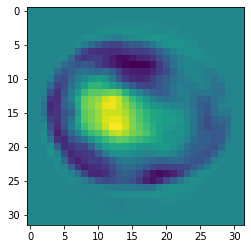

In [141]:
'''print('DC_spi:', DC_spi.shape)
print('DC_crt:', DC_crt.shape)'''


plt.figure
plt.imshow(np.sum(x_crt_reco[:,:,slc,2,:,0],2).real)

In [24]:
#N=160
y_pp_pred = test(x_pp)

In [14]:
y_pp_pred2 = test_2(x_raw[0:N,],hf_mat,af_mat,norm_x)

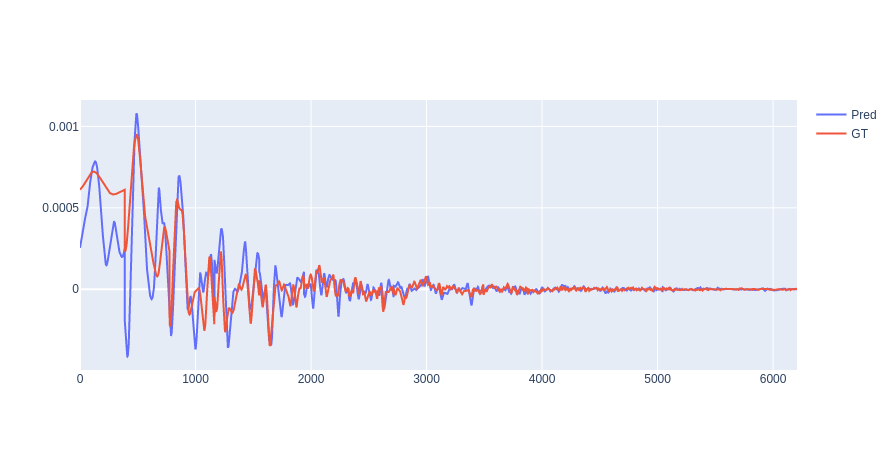

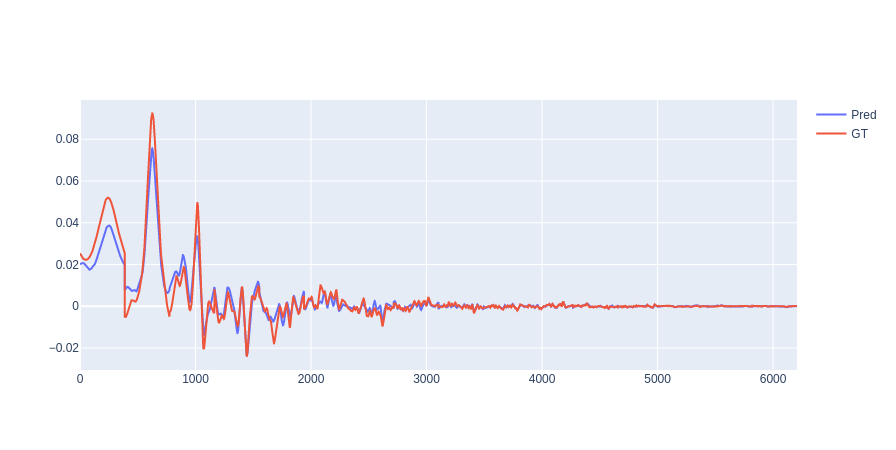

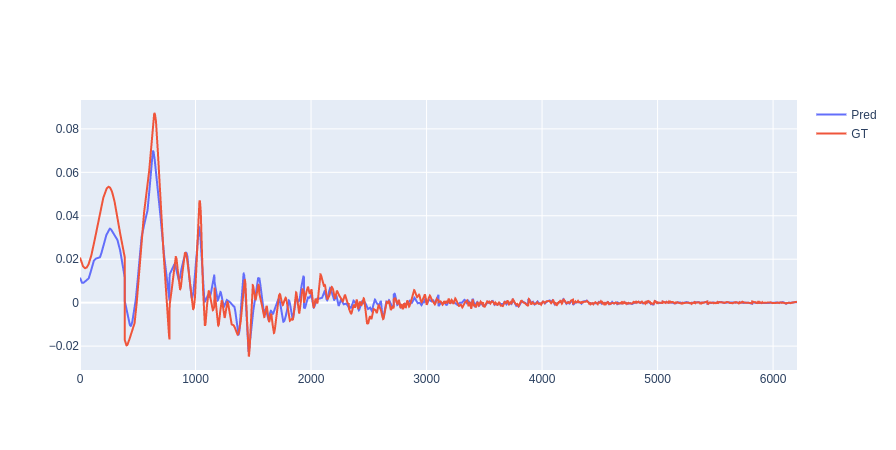

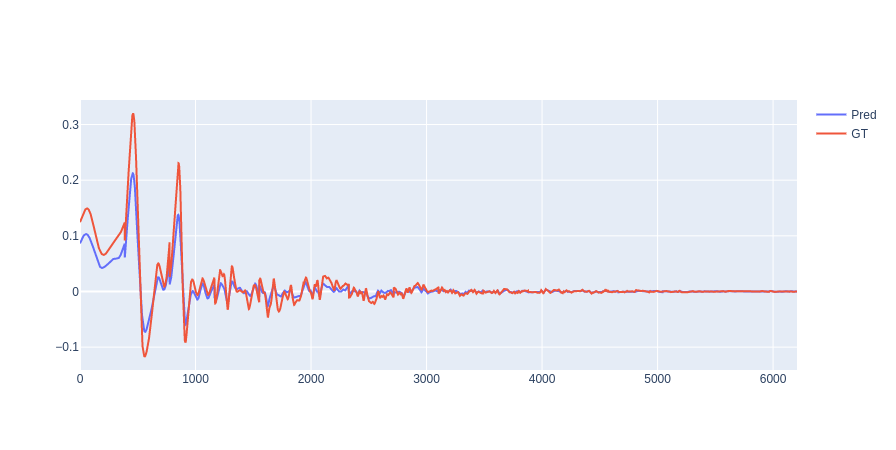

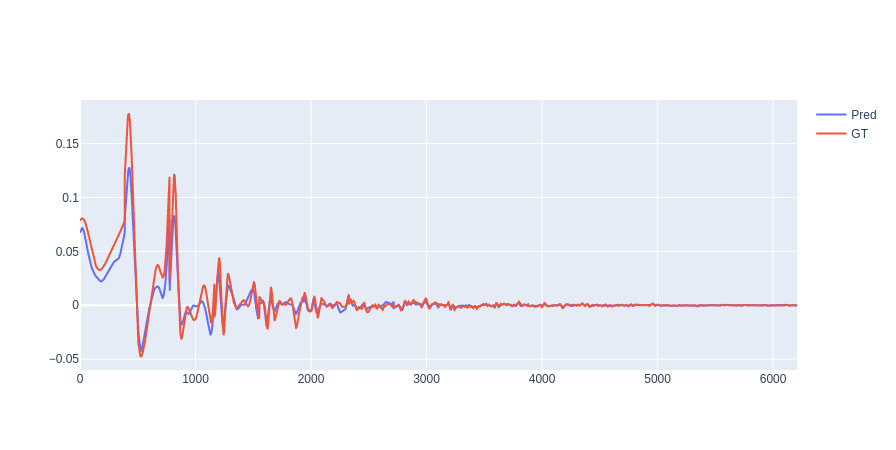

...

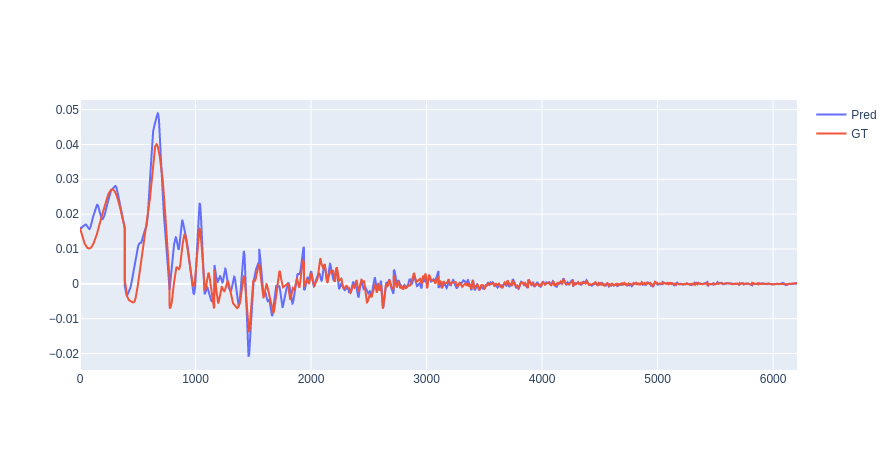

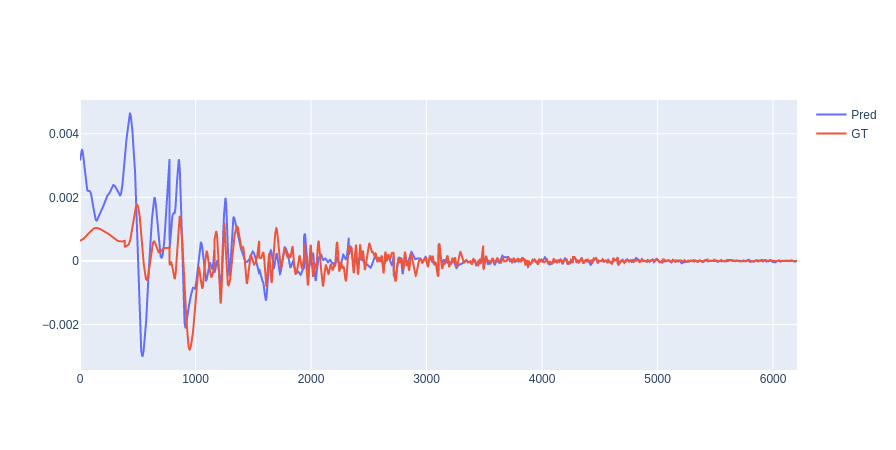

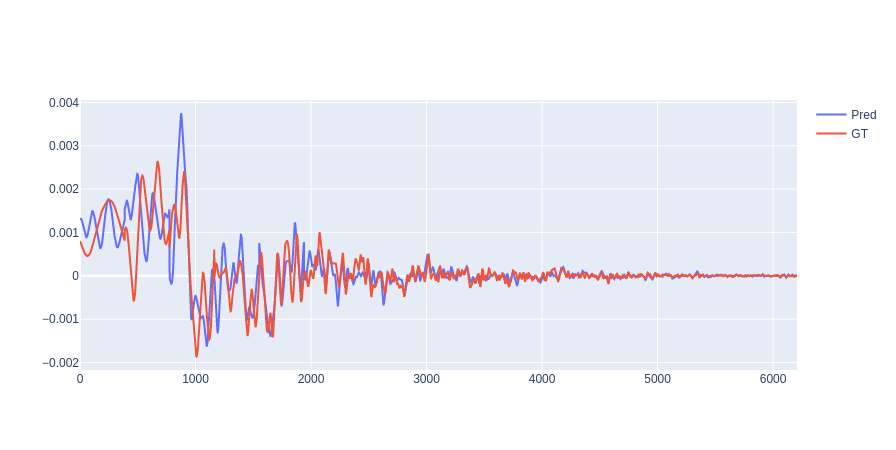

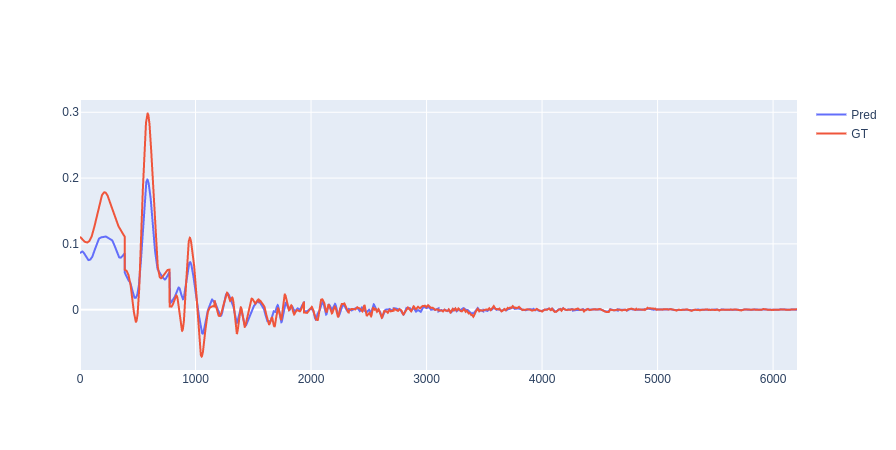

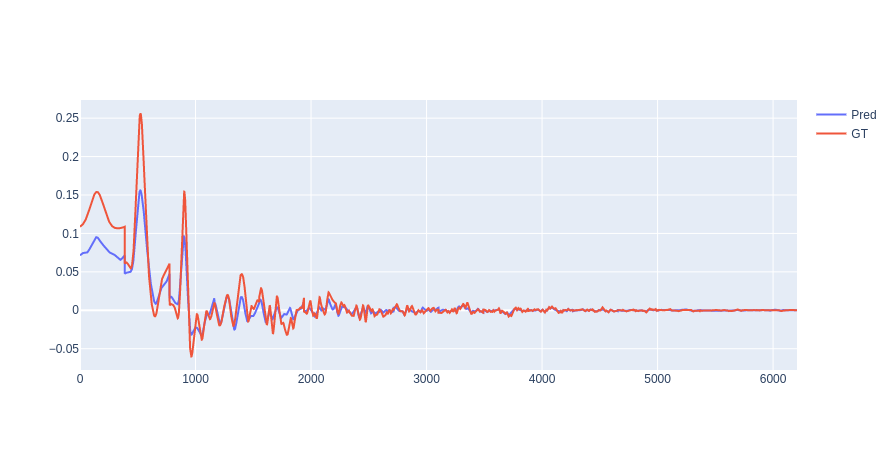

In [21]:
cae = 25
#coi =
for coi in np.arange(21,40):
    fig = go.Figure()
    fig.add_trace(go.Scatter(y=y_pp_pred[cae][:,coi],name='Pred'));
    fig.add_trace(go.Scatter(y=y_pp[cae,:,coi],name='GT'))
    fig.show()

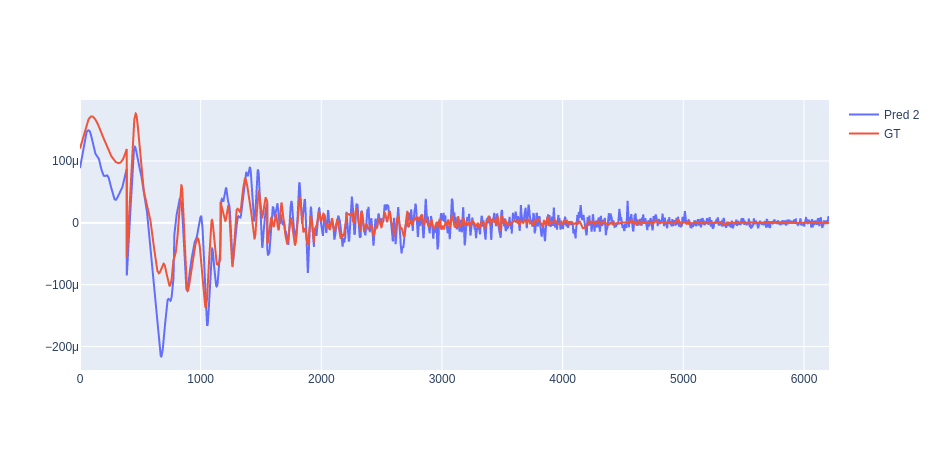

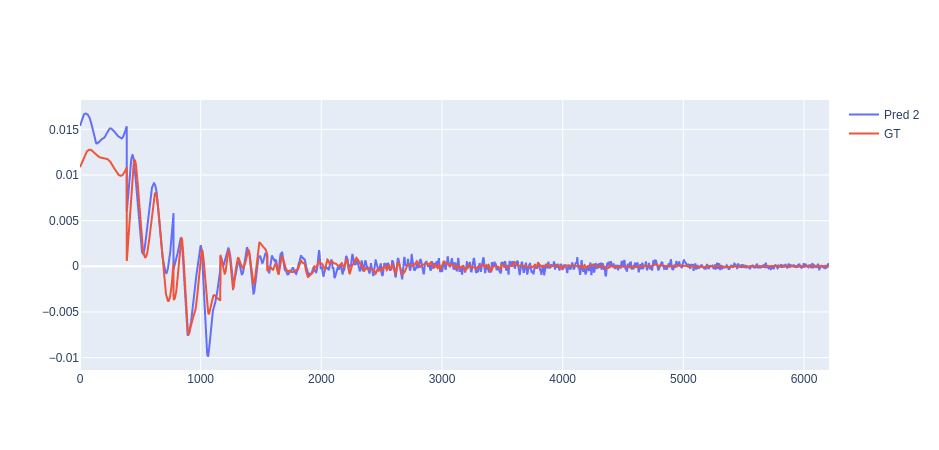

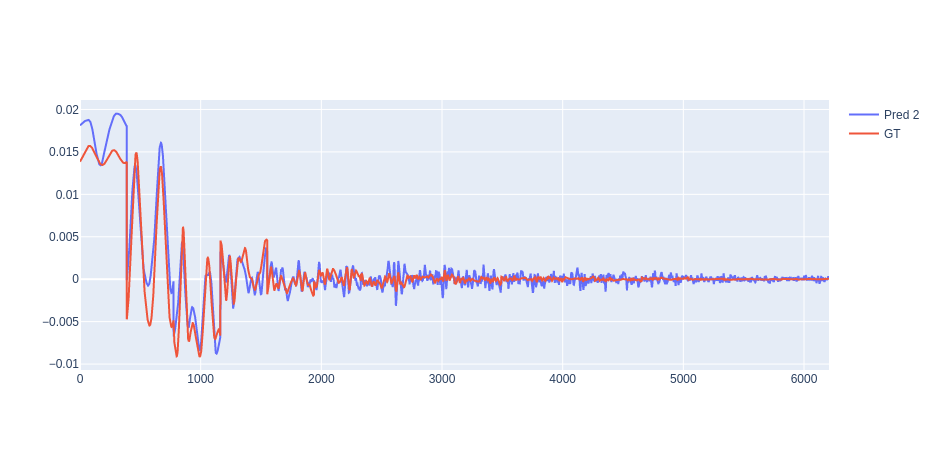

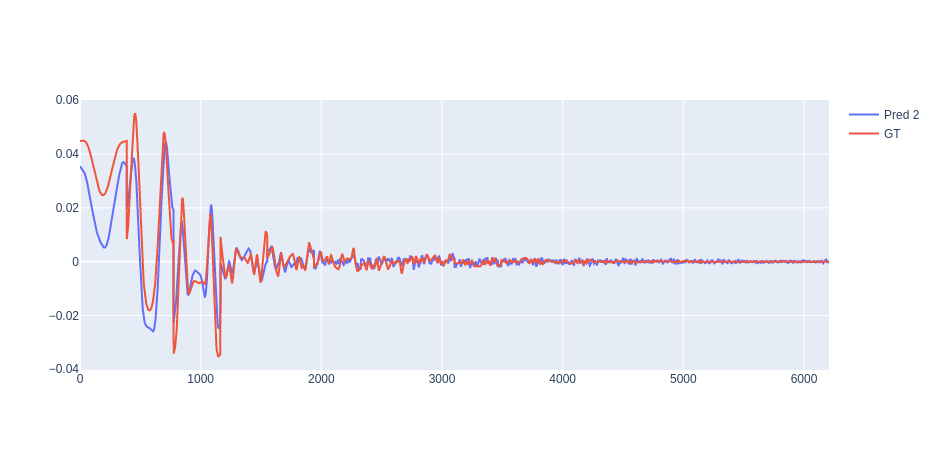

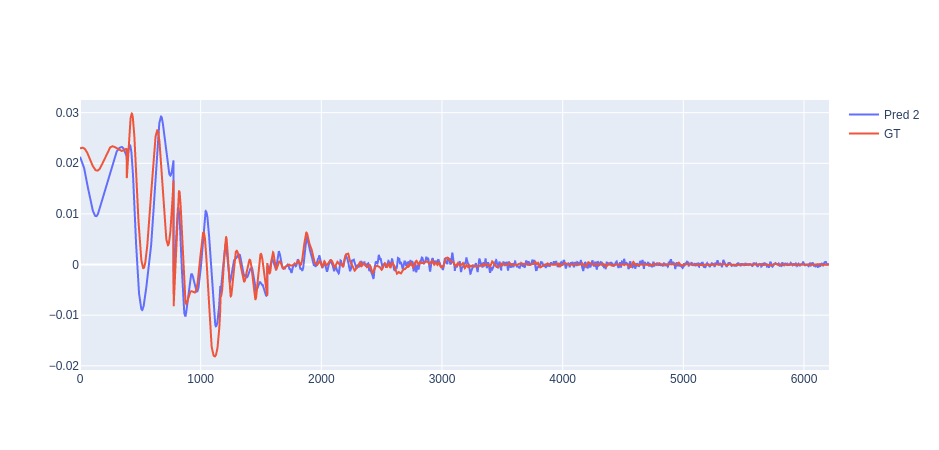

...

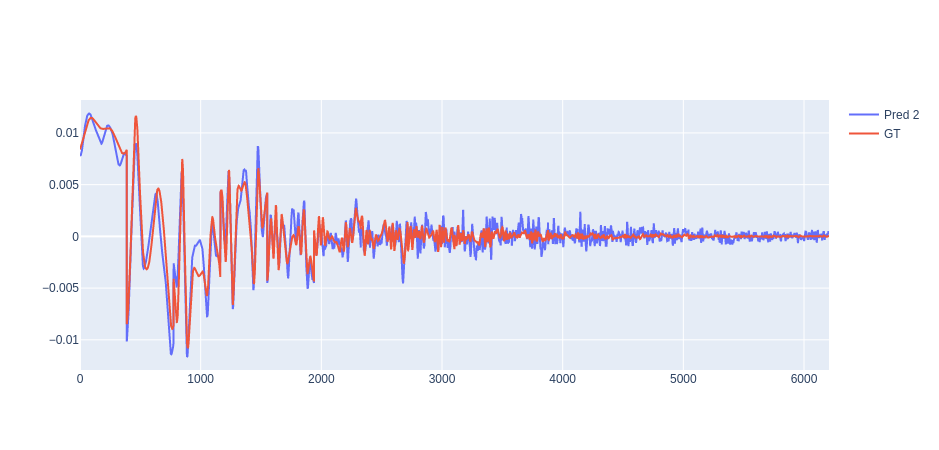

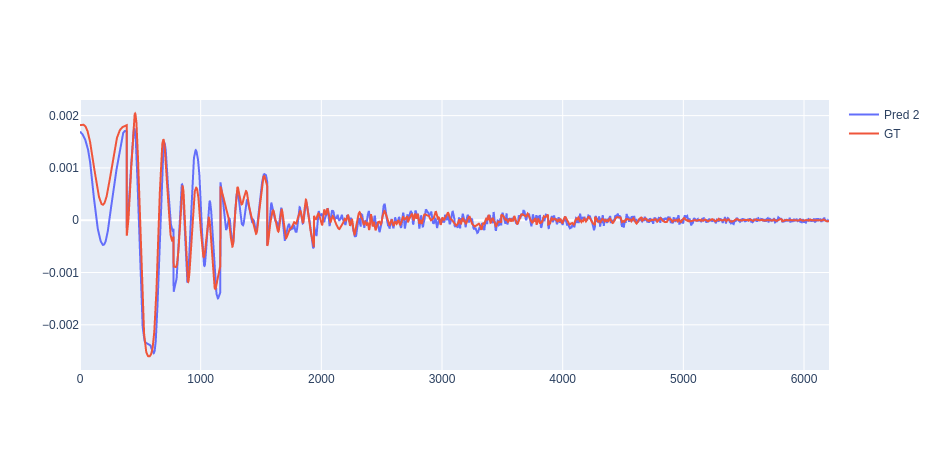

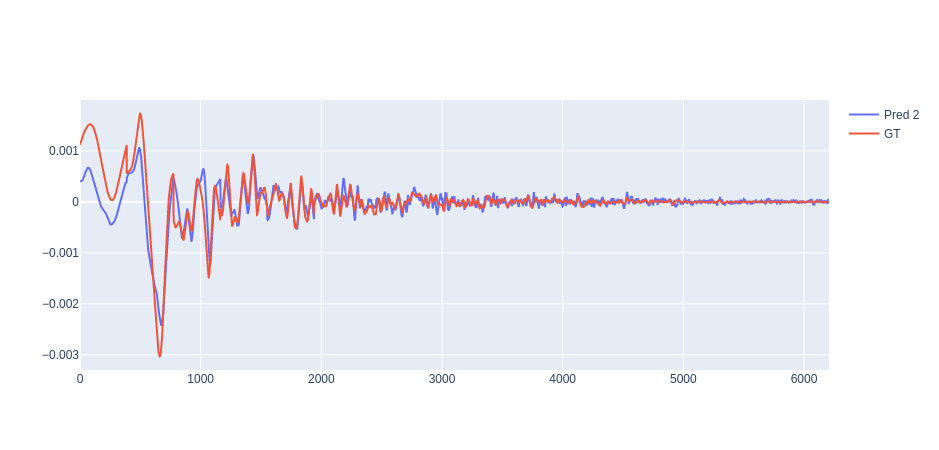

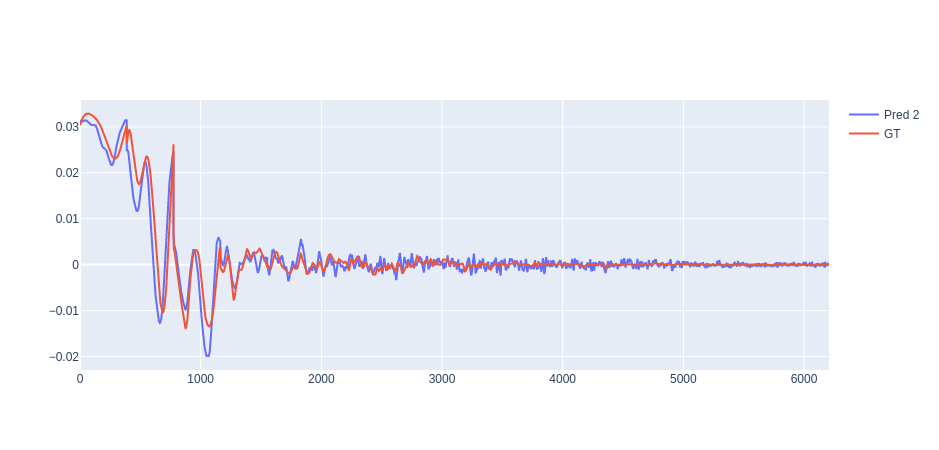

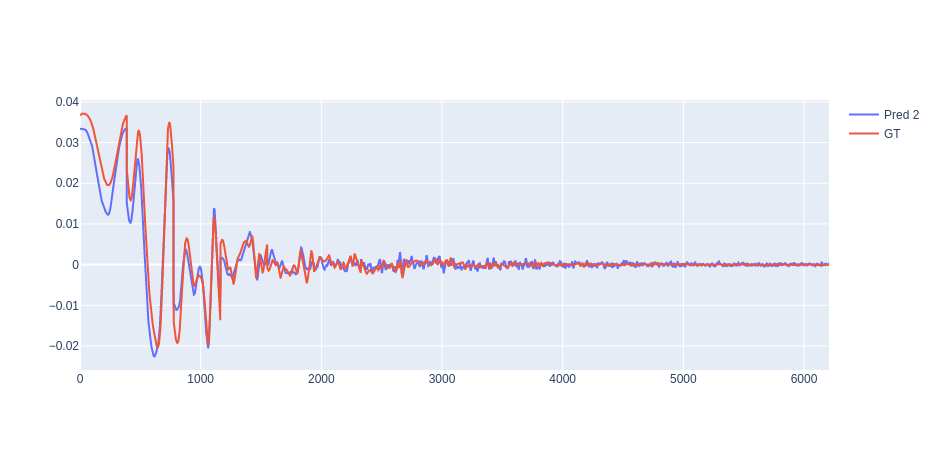

In [34]:
cae = 24
for coi in np.arange(21,40):
    fig = go.Figure()
    fig.add_trace(go.Scatter(y=y_pp_pred2[cae][:,coi],name='Pred 2'));
    fig.add_trace(go.Scatter(y=y_pp[cae,:,coi],name='GT'))
    fig.show()

In [ ]:
cae = 1
for coi in np.arange(0,20):
    ''
    fig = go.Figure()
    fig.add_trace(go.Scatter(y=y_pp_pred[cae][:,coi],name='Pred'));
    fig.add_trace(go.Scatter(y=y_pp[cae,:,coi].numpy(),name='GT'));
    fig.show()

In [ ]:
print(y_pp.shape)
print(y_pp_pred.__len__())
print(y_pp_pred[1].shape)

In [35]:
def interfer_with_test_data(pth2data, data_nam, labell, pth2save):
    
    sta_time = time.time()
    fh = h5py.File(pth2data+data_nam,'r')
    x_test = torch.tensor(fh[labell][:,:6208,:40],dtype=torch.float32)
    fh.close()
    print('Loaded in ', time.time()-sta_time)
    
    sta_time = time.time()
    x_test, dd, ddd = pre_processing(x_test, af_mat, hf_mat, n_coi=20)
    x_test_pred = test(x_test)
    print('Predicted in ', time.time()-sta_time)
    
    sta_time = time.time()
    fh = h5py.File(pth2save,'a')
    fh.create_dataset(labell+'_pr', data=x_test_pred)
    fh.close()
    print('Saved in ', time.time()-sta_time)
    

In [ ]:
path_to_data = '../../'
save_name_mrsi = 'Output_new_vol_1_val4.h5'

interfer_with_test_data(path_to_data, 'Valid_Test_Vol_001_BS.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_001_BS.h5', 'dat_ts', save_name_mrsi)

In [36]:
path_to_data = '../../'

save_name_mrsi = 'Janurary_Output_new_vol_1_new1.h5'

#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_001_BS.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_001_BS.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_2_new1.h5'

#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_002_LH.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_002_LH.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_4_new1.h5'

#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_004_AL.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_004_AL.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_8_new1.h5'

#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_008_LP.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_008_LP.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_9_new1.h5'

#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_009_LM.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_009_LM.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_10_new1.h5'

#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_010_BB.h5', 'dat_vl', save_name_mrsi)
interfer_with_test_data(path_to_data, 'Valid_Test_Vol_010_BB.h5', 'dat_ts', save_name_mrsi)



Loaded in  80.55553436279297
Predicted in  40.699177265167236
Saved in  17.27580451965332
Loaded in  82.61436104774475
Predicted in  40.34690260887146
Saved in  17.880265712738037
Loaded in  99.2302827835083
Predicted in  39.616185426712036
Saved in  14.40662169456482
Loaded in  92.8684298992157
Predicted in  39.79057860374451
Saved in  15.235466241836548
Loaded in  88.08373498916626
Predicted in  39.770851135253906
Saved in  15.102299451828003
Loaded in  93.34234523773193
Predicted in  40.28232002258301
Saved in  13.736863374710083


In [37]:
save_name_mrsi = 'Janurary_Output_new_vol_5_new1.h5'

interfer_with_test_data(path_to_data, 'Valid_Test_Vol_005_EH.h5', 'dat_vl', save_name_mrsi)
#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_005_EH.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_6_new1.h5'

interfer_with_test_data(path_to_data, 'Valid_Test_Vol_006_GH.h5', 'dat_vl', save_name_mrsi)
#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_006_GH.h5', 'dat_ts', save_name_mrsi)

save_name_mrsi = 'Janurary_Output_new_vol_7_new1.h5'

interfer_with_test_data(path_to_data, 'Valid_Test_Vol_007_DB.h5', 'dat_vl', save_name_mrsi)
#interfer_with_test_data(path_to_data, 'Valid_Test_Vol_007_DB.h5', 'dat_ts', save_name_mrsi)

Loaded in  94.06516337394714
Predicted in  39.68999481201172
Saved in  15.014641761779785
Loaded in  89.1466383934021
Predicted in  40.03518199920654
Saved in  13.641002655029297
Loaded in  96.75588345527649
Predicted in  40.06844663619995
Saved in  15.507500410079956


In [ ]:
# saved model
torch.save(model.state_dict(), './Saved_model_dgl_2_trained_withnoise.pt')

